In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


In [2]:
# Prepare file paths
benin_malanville_file_path = '../data/benin-malanville.csv'
sierraleone_bumbuna_file_path = '../data/sierraleone-bumbuna.csv'
togo_dapaong_q_file_path = '../data/togo-dapaong_qc.csv'


In [4]:
# Import CSV files
benin_df = pd.read_csv(benin_malanville_file_path)
sierraleone_df = pd.read_csv(sierraleone_bumbuna_file_path)
togo_df = pd.read_csv(togo_dapaong_q_file_path)

# Head the first 5 rows
print("Benin  Malanville")
print(benin_df.head(5))

print("Sierraleone Bumbuna")
print(sierraleone_df.head(5))

print("Togo Dapaong")
print(togo_df.head(5))

Benin  Malanville
          Timestamp  GHI  DNI  DHI  ModA  ModB  Tamb    RH   WS  WSgust  \
0  2021-08-09 00:01 -1.2 -0.2 -1.1   0.0   0.0  26.2  93.4  0.0     0.4   
1  2021-08-09 00:02 -1.1 -0.2 -1.1   0.0   0.0  26.2  93.6  0.0     0.0   
2  2021-08-09 00:03 -1.1 -0.2 -1.1   0.0   0.0  26.2  93.7  0.3     1.1   
3  2021-08-09 00:04 -1.1 -0.1 -1.0   0.0   0.0  26.2  93.3  0.2     0.7   
4  2021-08-09 00:05 -1.0 -0.1 -1.0   0.0   0.0  26.2  93.3  0.1     0.7   

   WSstdev     WD  WDstdev   BP  Cleaning  Precipitation  TModA  TModB  \
0      0.1  122.1      0.0  998         0            0.0   26.3   26.2   
1      0.0    0.0      0.0  998         0            0.0   26.3   26.2   
2      0.5  124.6      1.5  997         0            0.0   26.4   26.2   
3      0.4  120.3      1.3  997         0            0.0   26.4   26.3   
4      0.3  113.2      1.0  997         0            0.0   26.4   26.3   

   Comments  
0       NaN  
1       NaN  
2       NaN  
3       NaN  
4       NaN  
Si

## SECTION ONE
### Summary Statistics: 
Calculate the mean, median, standard deviation, and other statistical measures for each numeric column to understand data distribution.

In [5]:
# Summary statistics
benin_summary = benin_df.describe()
sierraleone_summary = sierraleone_df.describe()
togo_summary = togo_df.describe

# Display summary statistics
print("Benin  Malanville")
print(benin_summary)

print("Sierraleone Bumbuna")
print(sierraleone_summary)

print("Togo Dapaong")
print(togo_summary)

Benin  Malanville
                 GHI            DNI            DHI           ModA  \
count  525600.000000  525600.000000  525600.000000  525600.000000   
mean      240.559452     167.187516     115.358961     236.589496   
std       331.131327     261.710501     158.691074     326.894859   
min       -12.900000      -7.800000     -12.600000       0.000000   
25%        -2.000000      -0.500000      -2.100000       0.000000   
50%         1.800000      -0.100000       1.600000       4.500000   
75%       483.400000     314.200000     216.300000     463.700000   
max      1413.000000     952.300000     759.200000    1342.300000   

                ModB           Tamb             RH             WS  \
count  525600.000000  525600.000000  525600.000000  525600.000000   
mean      228.883576      28.179683      54.487969       2.121113   
std       316.536515       5.924297      28.073069       1.603466   
min         0.000000      11.000000       2.100000       0.000000   
25%         0.0

## SECTION TWO
### Data Quality Check: 
Look for missing values, outliers, or incorrect entries (e.g., negative values where only positive should exist), especially in columns like GHI, DNI, and DHI and check for outliers, especially in sensor readings (ModA, ModB) and wind speed data (WS, WSgust).

In [6]:
# Check for missing values in Benin dataset
print("Missing values in Benin dataset:")
print(benin_df.isnull().sum())

# Check for missing values in Sierra Leone dataset
print("\nMissing values in Sierra Leone dataset:")
print(sierraleone_df.isnull().sum())

# Check for missing values in Togo dataset
print("\nMissing values in Togo dataset:")
print(togo_df.isnull().sum())

Missing values in Benin dataset:
Timestamp             0
GHI                   0
DNI                   0
DHI                   0
ModA                  0
ModB                  0
Tamb                  0
RH                    0
WS                    0
WSgust                0
WSstdev               0
WD                    0
WDstdev               0
BP                    0
Cleaning              0
Precipitation         0
TModA                 0
TModB                 0
Comments         525600
dtype: int64

Missing values in Sierra Leone dataset:
Timestamp             0
GHI                   0
DNI                   0
DHI                   0
ModA                  0
ModB                  0
Tamb                  0
RH                    0
WS                    0
WSgust                0
WSstdev               0
WD                    0
WDstdev               0
BP                    0
Cleaning              0
Precipitation         0
TModA                 0
TModB                 0
Comments         525600
d

In [7]:
# Check for negative values in critical columns for Benin
negative_values_benin = benin_df[(benin_df['GHI'] < 0) | (benin_df['DNI'] < 0) | (benin_df['DHI'] < 0)]
print(f"Number of rows with negative values in Benin dataset: {len(negative_values_benin)}")

# Repeat for Sierra Leone
negative_values_sierraleone = sierraleone_df[(sierraleone_df['GHI'] < 0) | (sierraleone_df['DNI'] < 0) | (sierraleone_df['DHI'] < 0)]
print(f"Number of rows with negative values in Sierra Leone dataset: {len(negative_values_sierraleone)}")

# Repeat for Togo
negative_values_togo = togo_df[(togo_df['GHI'] < 0) | (togo_df['DNI'] < 0) | (togo_df['DHI'] < 0)]
print(f"Number of rows with negative values in Togo dataset: {len(negative_values_togo)}")

Number of rows with negative values in Benin dataset: 278722
Number of rows with negative values in Sierra Leone dataset: 286728
Number of rows with negative values in Togo dataset: 257385


In [8]:
# Function to detect outliers using IQR
def detect_outliers(data, column):
    Q1 = data[column].quantile(0.25)
    Q3 = data[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = data[(data[column] < lower_bound) | (data[column] > upper_bound)]
    return outliers

# Check for outliers in ModA, ModB, WS, WSgust for Benin
moda_outliers_benin = detect_outliers(benin_df, 'ModA')
modb_outliers_benin = detect_outliers(benin_df, 'ModB')
ws_outliers_benin = detect_outliers(benin_df, 'WS')
wsgust_outliers_benin = detect_outliers(benin_df, 'WSgust')

print(f"Outliers in ModA (Benin): {len(moda_outliers_benin)}")
print(f"Outliers in ModB (Benin): {len(modb_outliers_benin)}")
print(f"Outliers in WS (Benin): {len(ws_outliers_benin)}")
print(f"Outliers in WSgust (Benin): {len(wsgust_outliers_benin)}")

# Repeat for Sierra Leone
moda_outliers_sierraleone = detect_outliers(sierraleone_df, 'ModA')
modb_outliers_sierraleone = detect_outliers(sierraleone_df, 'ModB')
ws_outliers_sierraleone = detect_outliers(sierraleone_df, 'WS')
wsgust_outliers_sierraleone = detect_outliers(sierraleone_df, 'WSgust')

print(f"Outliers in ModA (Sierra Leone): {len(moda_outliers_sierraleone)}")
print(f"Outliers in ModB (Sierra Leone): {len(modb_outliers_sierraleone)}")
print(f"Outliers in WS (Sierra Leone): {len(ws_outliers_sierraleone)}")
print(f"Outliers in WSgust (Sierra Leone): {len(wsgust_outliers_sierraleone)}")

# Repeat for Togo
moda_outliers_togo = detect_outliers(togo_df, 'ModA')
modb_outliers_togo = detect_outliers(togo_df, 'ModB')
ws_outliers_togo = detect_outliers(togo_df, 'WS')
wsgust_outliers_togo = detect_outliers(togo_df, 'WSgust')

print(f"Outliers in ModA (Togo): {len(moda_outliers_togo)}")
print(f"Outliers in ModB (Togo): {len(modb_outliers_togo)}")
print(f"Outliers in WS (Togo): {len(ws_outliers_togo)}")
print(f"Outliers in WSgust (Togo): {len(wsgust_outliers_togo)}")

Outliers in ModA (Benin): 98
Outliers in ModB (Benin): 240
Outliers in WS (Benin): 6717
Outliers in WSgust (Benin): 5368
Outliers in ModA (Sierra Leone): 21017
Outliers in ModB (Sierra Leone): 20613
Outliers in WS (Sierra Leone): 3169
Outliers in WSgust (Sierra Leone): 3665
Outliers in ModA (Togo): 1237
Outliers in ModB (Togo): 1537
Outliers in WS (Togo): 8708
Outliers in WSgust (Togo): 7377


In [9]:
# Drop the 'Comments' column from all datasets
benin_df.drop(columns=['Comments'], inplace=True)
sierraleone_df.drop(columns=['Comments'], inplace=True)
togo_df.drop(columns=['Comments'], inplace=True)

In [19]:
# Replace negative values with 0 in 'GHI', 'DNI', 'DHI' columns
GHI_DNI_DHI = ['GHI', 'DNI', 'DHI']
for col in GHI_DNI_DHI:
    benin_df[col] = benin_df[col].apply(lambda x: np.nan if x < 0 else x)
    sierraleone_df[col] = sierraleone_df[col].apply(lambda x: np.nan if x < 0 else x)
    togo_df[col] = togo_df[col].apply(lambda x: np.nan if x < 0 else x)

In [23]:
# Percentage of missing values in GHI_DNI_DHI columns
print("Missing values after replacing negatives:")
print(benin_df[GHI_DNI_DHI].isnull().mean() * 100)
print(sierraleone_df[GHI_DNI_DHI].isnull().mean() * 100)
print(togo_df[GHI_DNI_DHI].isnull().mean() * 100)

# Fill them with column mean/median
for col in GHI_DNI_DHI:
    benin_df[col] = benin_df[col].fillna(benin_df[col].mean())
    sierraleone_df[col] = sierraleone_df[col].fillna(sierraleone_df[col].mean())
    togo_df[col] = togo_df[col].fillna(togo_df[col].mean())

Missing values after replacing negatives:
GHI    0.0
DNI    0.0
DHI    0.0
dtype: float64
GHI    0.0
DNI    0.0
DHI    0.0
dtype: float64
GHI    0.0
DNI    0.0
DHI    0.0
dtype: float64


In [24]:
def cap_outliers(data, column):
    Q1 = data[column].quantile(0.25)
    Q3 = data[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    # Cap values to boundaries
    data[column] = data[column].apply(lambda x: lower_bound if x < lower_bound else (upper_bound if x > upper_bound else x))

# Apply to sensor and wind columns for all datasets
outlier_columns = ['ModA', 'ModB', 'WS', 'WSgust']
for col in outlier_columns:
    cap_outliers(benin_df, col)
    cap_outliers(sierraleone_df, col)
    cap_outliers(togo_df, col)

In [25]:
# Save cleaned datasets to new CSV files
benin_df.to_csv('../data/benin_cleaned.csv', index=False)
sierraleone_df.to_csv('../data/sierraleone_cleaned.csv', index=False)
togo_df.to_csv('../data/togo_cleaned.csv', index=False)

## SECTION THREE
### Time Series Analysis: 
Plot bar charts or line charts  of GHI, DNI, DHI, and Tamb over time to observe patterns by month, trends throughout day, or anomalies, such as peaks in solar irradiance or temperature fluctuations. 

In [26]:
# Convert Timestamp to datetime for all datasets
benin_df['Timestamp'] = pd.to_datetime(benin_df['Timestamp'])
sierraleone_df['Timestamp'] = pd.to_datetime(sierraleone_df['Timestamp'])
togo_df['Timestamp'] = pd.to_datetime(togo_df['Timestamp'])

# Set Timestamp as the index for easier plotting
benin_df.set_index('Timestamp', inplace=True)
sierraleone_df.set_index('Timestamp', inplace=True)
togo_df.set_index('Timestamp', inplace=True)

In [27]:
# Resample to daily averages
benin_daily = benin_df[['GHI', 'DNI', 'DHI', 'Tamb']].resample('D').mean()
sierraleone_daily = sierraleone_df[['GHI', 'DNI', 'DHI', 'Tamb']].resample('D').mean()
togo_daily = togo_df[['GHI', 'DNI', 'DHI', 'Tamb']].resample('D').mean()

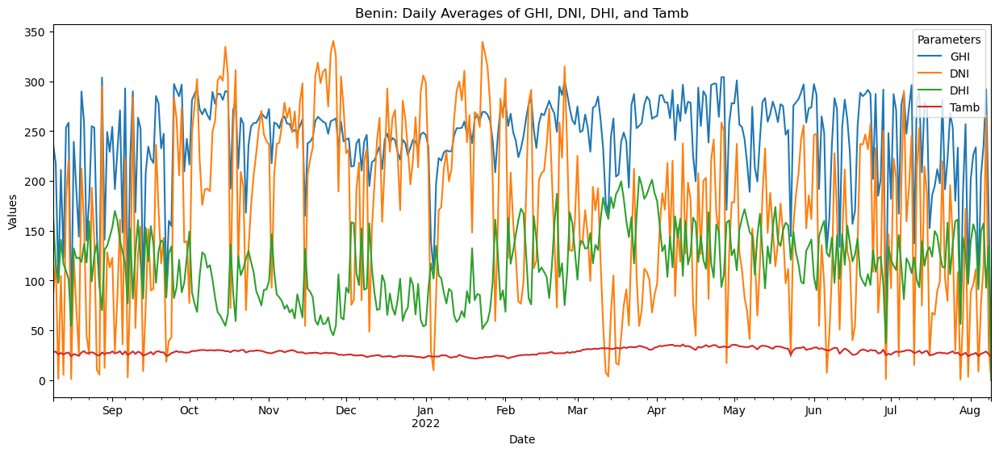

In [28]:
# Plot GHI, DNI, DHI, and Tamb for Benin
benin_daily[['GHI', 'DNI', 'DHI', 'Tamb']].plot(figsize=(15, 6), title="Benin: Daily Averages of GHI, DNI, DHI, and Tamb", ylabel="Values", xlabel="Date")
plt.legend(title="Parameters")
plt.show()

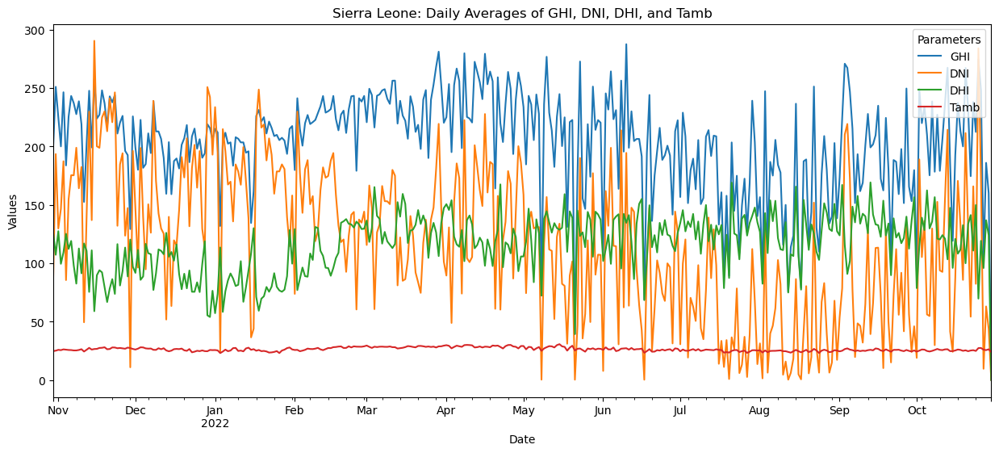

In [29]:
# Plot GHI, DNI, DHI, and Tamb for Sierra Leone
sierraleone_daily[['GHI', 'DNI', 'DHI', 'Tamb']].plot(figsize=(15, 6), title="Sierra Leone: Daily Averages of GHI, DNI, DHI, and Tamb", ylabel="Values", xlabel="Date")
plt.legend(title="Parameters")
plt.show()

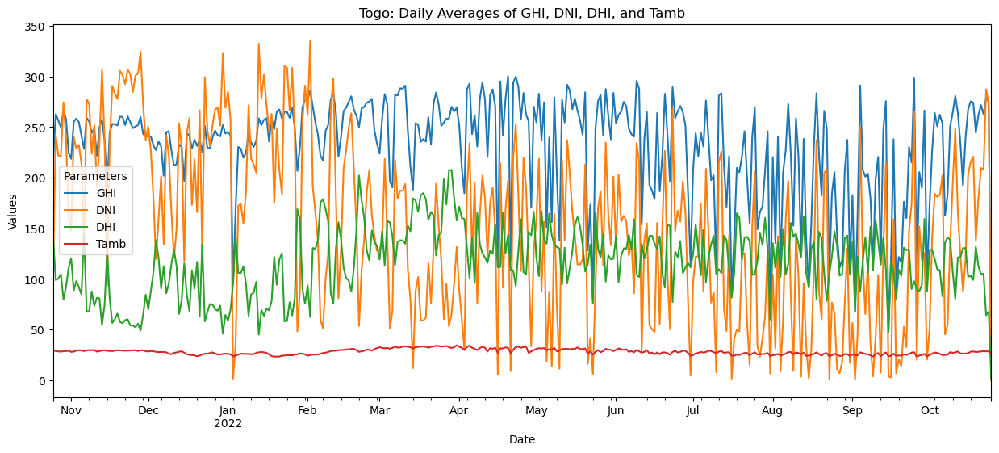

In [30]:
# Plot GHI, DNI, DHI, and Tamb for Togo
togo_daily[['GHI', 'DNI', 'DHI', 'Tamb']].plot(figsize=(15, 6), title="Togo: Daily Averages of GHI, DNI, DHI, and Tamb", ylabel="Values", xlabel="Date")
plt.legend(title="Parameters")
plt.show()

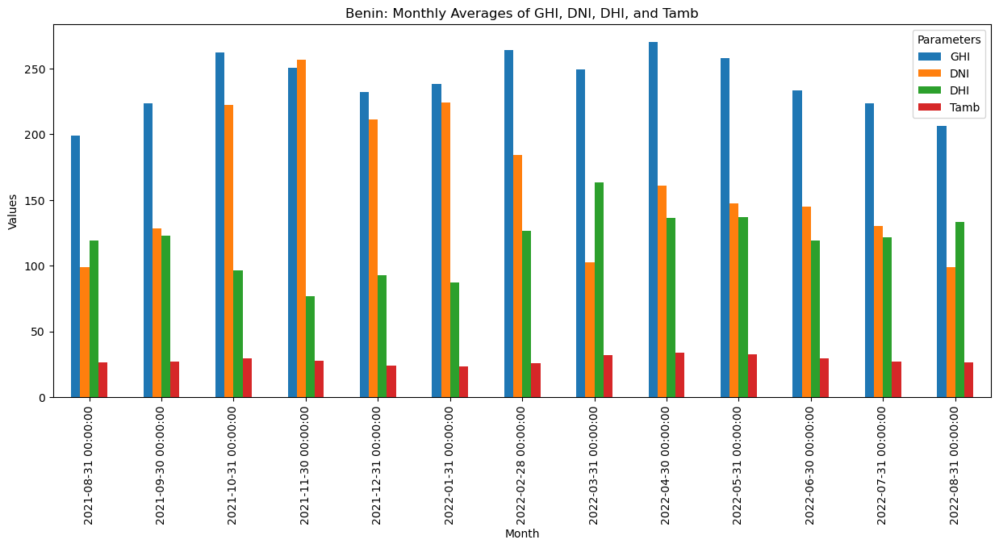

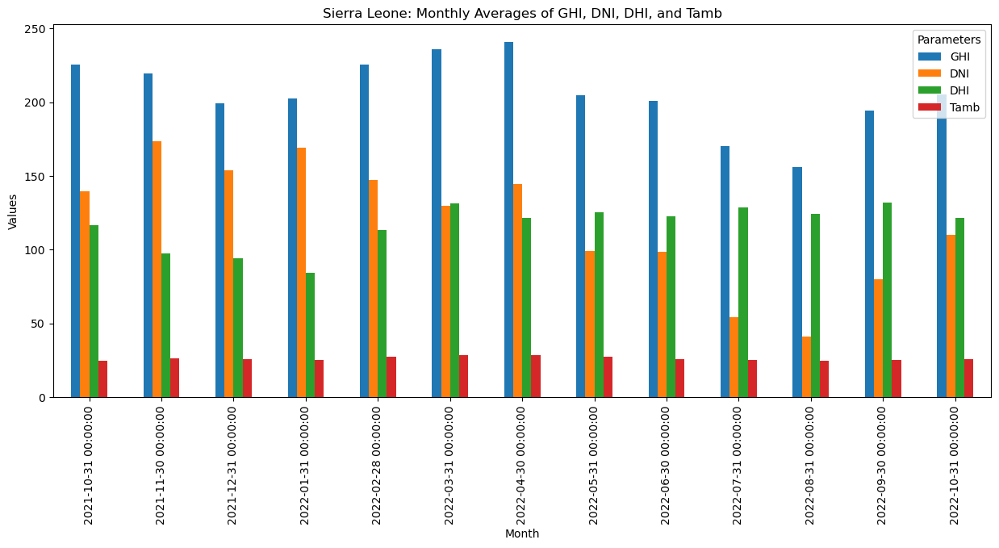

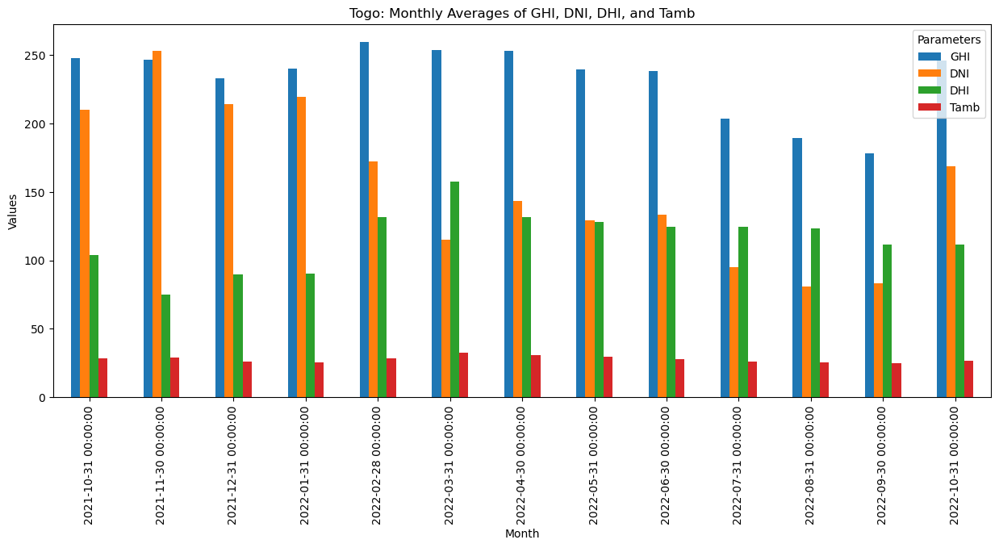

In [32]:
# Resample to monthly averages
benin_monthly = benin_df[['GHI', 'DNI', 'DHI', 'Tamb']].resample('ME').mean()
sierraleone_monthly = sierraleone_df[['GHI', 'DNI', 'DHI', 'Tamb']].resample('ME').mean()
togo_monthly = togo_df[['GHI', 'DNI', 'DHI', 'Tamb']].resample('ME').mean()

# Plot for Benin
benin_monthly[['GHI', 'DNI', 'DHI', 'Tamb']].plot(kind='bar', figsize=(15, 6), title="Benin: Monthly Averages of GHI, DNI, DHI, and Tamb", ylabel="Values", xlabel="Month")
plt.legend(title="Parameters")
plt.show()

# Plot for Sierra Leone
sierraleone_monthly[['GHI', 'DNI', 'DHI', 'Tamb']].plot(kind='bar', figsize=(15, 6), title="Sierra Leone: Monthly Averages of GHI, DNI, DHI, and Tamb", ylabel="Values", xlabel="Month")
plt.legend(title="Parameters")
plt.show()

# Plot for Togo
togo_monthly[['GHI', 'DNI', 'DHI', 'Tamb']].plot(kind='bar', figsize=(15, 6), title="Togo: Monthly Averages of GHI, DNI, DHI, and Tamb", ylabel="Values", xlabel="Month")
plt.legend(title="Parameters")
plt.show()

#### Observations
1. Daily Averages (Line Charts)
   - GHI (Global Horizontal Irradiance): Shows a relatively consistent trend with occasional spikes and dips, indicating variations in sunlight availability over the year.
   - DNI (Direct Normal Irradiance): Fluctuates heavily day-to-day, indicating the impact of direct sunlight exposure and atmospheric conditions.
   - DHI (Diffuse Horizontal Irradiance): Relatively stable with smaller fluctuations, as it depends on scattered light, less influenced by clouds.
   - Tamb (Ambient Temperature): Remains relatively stable across the year with minor fluctuations.
2. Monthly Averages (Bar Charts)
   - All datasets exhibit a seasonal pattern where solar radiation (GHI, DNI, DHI) increases during certain months and decreases during others, likely corresponding to dry and rainy seasons.
   - Ambient temperature (Tamb) remains stable across months, indicating less seasonal variability.

In [35]:
# Define a function to calculate Z-scores and detect anomalies
def detect_anomalies_zscore(data, column):
    mean = data[column].mean()
    std = data[column].std()
    z_scores = (data[column] - mean) / std
    anomalies = data[(z_scores > 3) | (z_scores < -3)]  # Z-scores > 3 or < -3 are anomalies
    return anomalies

# Detect anomalies for GHI in Benin dataset
ghi_anomalies_benin = detect_anomalies_zscore(benin_daily, 'GHI')
dni_anomalies_benin = detect_anomalies_zscore(benin_daily, 'DNI')
dhi_anomalies_benin = detect_anomalies_zscore(benin_daily, 'DHI')
tamb_anomalies_benin = detect_anomalies_zscore(benin_daily, 'Tamb')

# Print results
print("Benin - GHI Anomalies:")
print(ghi_anomalies_benin)

Benin - GHI Anomalies:
                  GHI        DNI        DHI       Tamb
Timestamp                                             
2021-08-16  55.303958   0.815833  54.283681  23.684583
2021-08-27  96.211597   5.343403  93.502708  24.644306
2021-09-07  79.342222   2.471250  76.678333  24.947847
2021-09-13  90.115278   8.819167  81.784375  24.382986
2021-09-22  90.070417  18.222292  82.816597  24.121458
2022-06-29  37.480278   0.841181  37.005417  24.836111
2022-07-28  56.527292   0.125347  56.222778  24.613889
2022-08-04  95.335347   8.271528  91.037639  23.951528
2022-08-09   0.000000   0.000000   0.000000  23.100000


In [36]:
# Define a function to detect anomalies using the IQR method
def detect_anomalies_iqr(data, column):
    Q1 = data[column].quantile(0.25)  # 25th percentile
    Q3 = data[column].quantile(0.75)  # 75th percentile
    IQR = Q3 - Q1  # Interquartile range
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    anomalies = data[(data[column] < lower_bound) | (data[column] > upper_bound)]  # Filter anomalies
    return anomalies

# Detect anomalies for GHI in Benin dataset
ghi_anomalies_benin = detect_anomalies_iqr(benin_daily, 'GHI')
dni_anomalies_benin = detect_anomalies_iqr(benin_daily, 'DNI')
dhi_anomalies_benin = detect_anomalies_iqr(benin_daily, 'DHI')
tamb_anomalies_benin = detect_anomalies_iqr(benin_daily, 'Tamb')

# Print results
print("Benin - GHI Anomalies:")
print(ghi_anomalies_benin)

Benin - GHI Anomalies:
                   GHI        DNI         DHI       Tamb
Timestamp                                               
2021-08-11   98.595347   1.060556   97.408403  25.679167
2021-08-13  122.398958   5.152292  116.591597  25.649583
2021-08-16   55.303958   0.815833   54.283681  23.684583
2021-08-19  143.985764  25.801806  122.870139  24.130069
2021-08-22  140.269653  44.635278  117.884375  26.743681
2021-08-26  145.771667  10.110000  137.176528  24.906458
2021-08-27   96.211597   5.343403   93.502708  24.644306
2021-08-29  140.877500  12.187847  130.931528  25.932153
2021-09-05  148.220903  35.815069  128.921944  25.577847
2021-09-07   79.342222   2.471250   76.678333  24.947847
2021-09-13   90.115278   8.819167   81.784375  24.382986
2021-09-22   90.070417  18.222292   82.816597  24.121458
2021-09-24  154.492917  42.624236  134.186319  26.948889
2022-01-03  138.739306  28.995625  116.906736  23.617083
2022-01-04  111.078125   9.716181  101.887569  23.367014
2022-05-

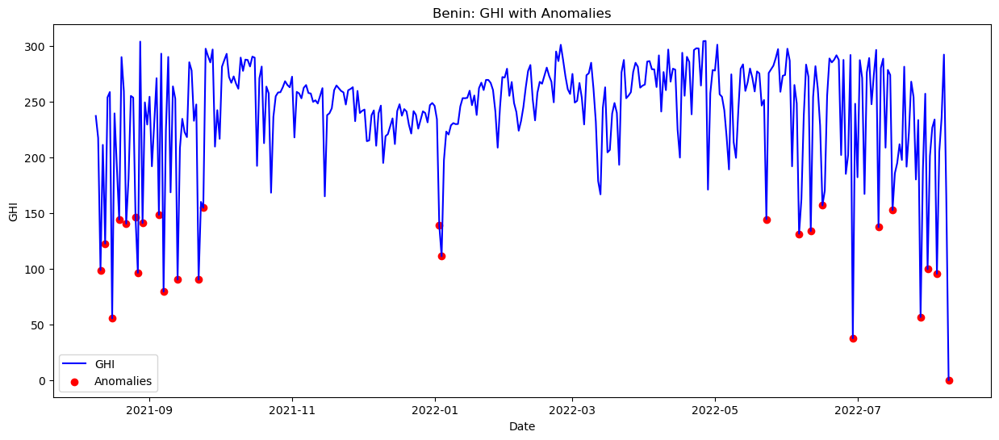

In [37]:
# Plot GHI with anomalies for Benin
plt.figure(figsize=(15, 6))
plt.plot(benin_daily.index, benin_daily['GHI'], label='GHI', color='blue')
plt.scatter(ghi_anomalies_benin.index, ghi_anomalies_benin['GHI'], color='red', label='Anomalies')
plt.title("Benin: GHI with Anomalies")
plt.xlabel("Date")
plt.ylabel("GHI")
plt.legend()
plt.show()

#### Observations
1. Anomalies Detected:
    - Sudden drops in GHI (e.g., close to zero) can indicate cloudy days, sensor malfunctions, or maintenance activities.
    - These anomalies could also be caused by cleaning activities, bad weather, or unexpected environmental conditions.
2. Frequent Pattern
    - Many anomalies are clustered during certain time periods (e.g., late 2021 and mid-2022). These periods might represent seasonal effects, such as increased cloud cover or monsoon/rainy seasons.

## SECTION FOUR
### Evaluate the impact
Evaluate the impact of cleaning (using the 'Cleaning' column) on the sensor readings (ModA, ModB) over time.


In [38]:
# Calculate average sensor readings based on cleaning status
cleaning_impact_benin = benin_df.groupby('Cleaning')[['ModA', 'ModB']].mean()
cleaning_impact_sierraleone = sierraleone_df.groupby('Cleaning')[['ModA', 'ModB']].mean()
cleaning_impact_togo = togo_df.groupby('Cleaning')[['ModA', 'ModB']].mean()

# Print results
print("Benin - Impact of Cleaning on Sensor Readings:")
print(cleaning_impact_benin)
print("\nSierra Leone - Impact of Cleaning on Sensor Readings:")
print(cleaning_impact_sierraleone)
print("\nTogo - Impact of Cleaning on Sensor Readings:")
print(cleaning_impact_togo)

Benin - Impact of Cleaning on Sensor Readings:
                ModA        ModB
Cleaning                        
0         236.515263  228.795415
1         307.229278  301.972165

Sierra Leone - Impact of Cleaning on Sensor Readings:
                ModA        ModB
Cleaning                        
0         203.353679  194.670685
1         273.294980  277.175000

Togo - Impact of Cleaning on Sensor Readings:
                ModA        ModB
Cleaning                        
0         225.844380  219.231042
1         534.989413  531.934164


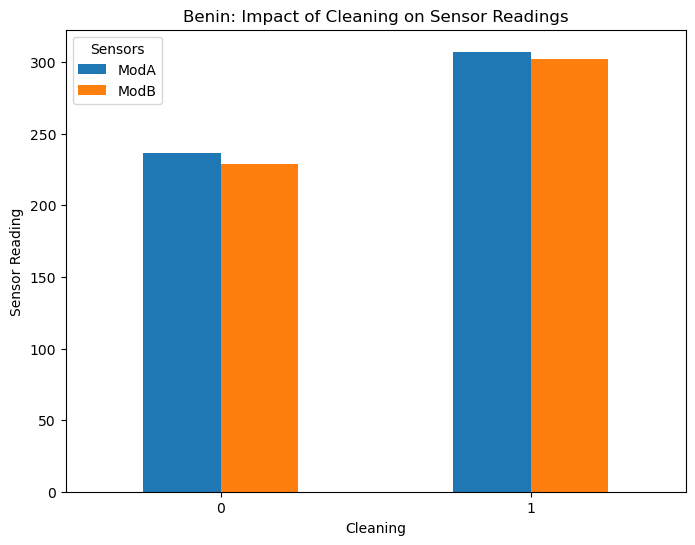

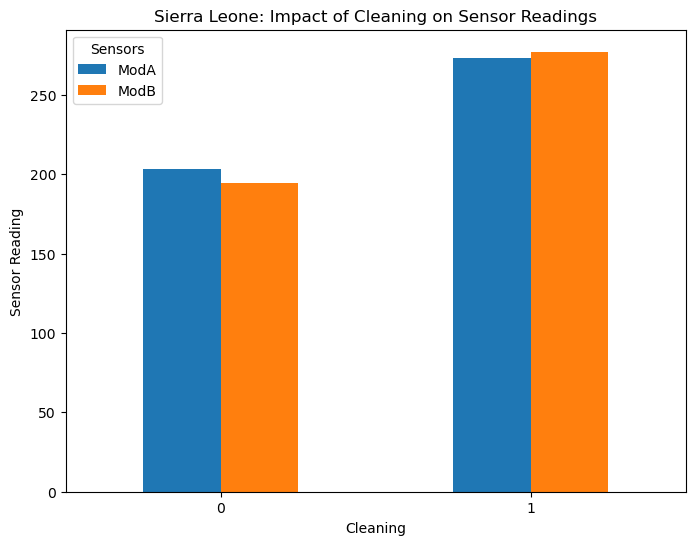

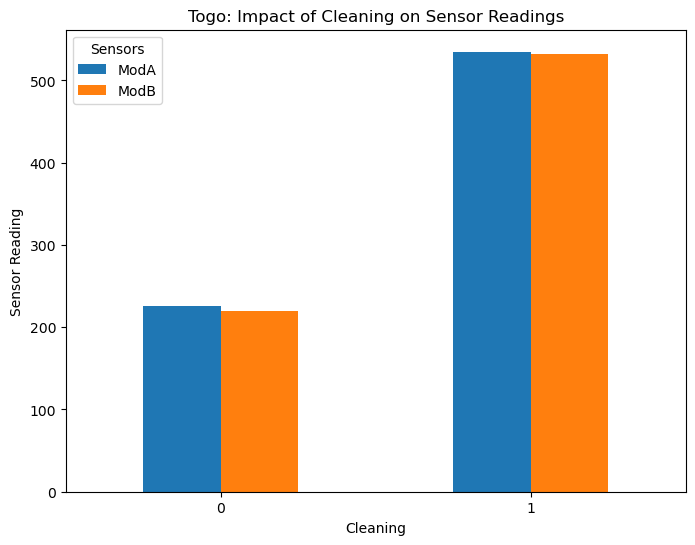

In [39]:
# Bar plot for Benin
cleaning_impact_benin.plot(kind='bar', figsize=(8, 6), title="Benin: Impact of Cleaning on Sensor Readings", ylabel="Sensor Reading")
plt.xticks(rotation=0)
plt.legend(title="Sensors")
plt.show()

# Bar plot for Sierra Leone
cleaning_impact_sierraleone.plot(kind='bar', figsize=(8, 6), title="Sierra Leone: Impact of Cleaning on Sensor Readings", ylabel="Sensor Reading")
plt.xticks(rotation=0)
plt.legend(title="Sensors")
plt.show()

# Bar plot for Togo
cleaning_impact_togo.plot(kind='bar', figsize=(8, 6), title="Togo: Impact of Cleaning on Sensor Readings", ylabel="Sensor Reading")
plt.xticks(rotation=0)
plt.legend(title="Sensors")
plt.show()

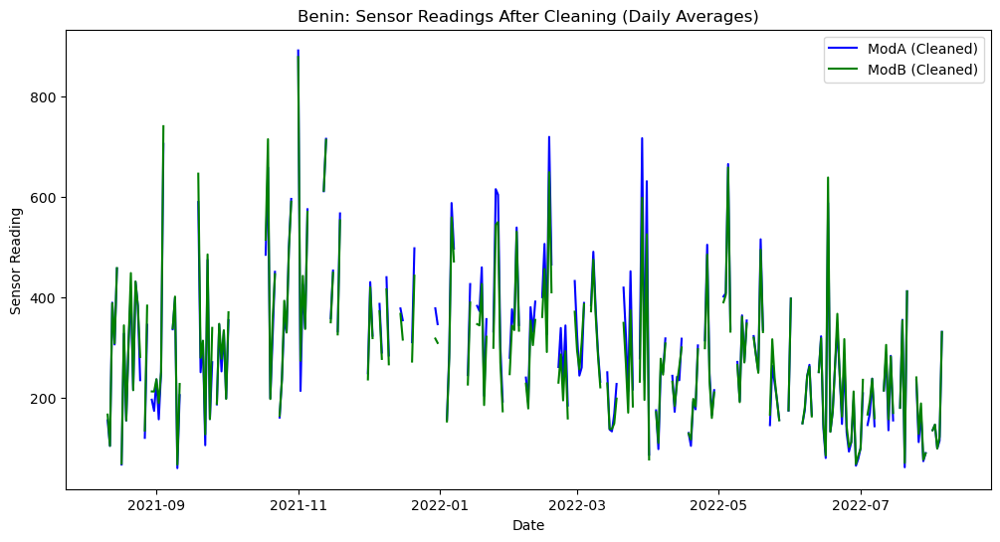

In [40]:
# Filter data where cleaning occurred
benin_cleaning_events = benin_df[benin_df['Cleaning'] == 1]
sierraleone_cleaning_events = sierraleone_df[sierraleone_df['Cleaning'] == 1]
togo_cleaning_events = togo_df[togo_df['Cleaning'] == 1]

# Resample to daily averages for better visualization
benin_cleaning_daily = benin_cleaning_events[['ModA', 'ModB']].resample('D').mean()
sierraleone_cleaning_daily = sierraleone_cleaning_events[['ModA', 'ModB']].resample('D').mean()
togo_cleaning_daily = togo_cleaning_events[['ModA', 'ModB']].resample('D').mean()

plt.figure(figsize=(12, 6))
plt.plot(benin_cleaning_daily.index, benin_cleaning_daily['ModA'], label='ModA (Cleaned)', color='blue')
plt.plot(benin_cleaning_daily.index, benin_cleaning_daily['ModB'], label='ModB (Cleaned)', color='green')
plt.title("Benin: Sensor Readings After Cleaning (Daily Averages)")
plt.xlabel("Date")
plt.ylabel("Sensor Reading")
plt.legend()
plt.show()

#### Observations
1. Average Sensor Readings Before and After Cleaning (Bar Charts)
   A. Increase in ModA and ModB after cleaning
       - Across all datasets, the average sensor readings (ModA and ModB) are significantly higher when cleaning occurred (Cleaning = 1) compared to when it didn’t (Cleaning = 0).
       - This indicates that cleaning the sensors improves their performance, as the accumulation of dust or debris can hinder their ability to accurately measure irradiance.
   B. Difference Between ModA and ModB
       - The improvement after cleaning is consistent across both sensors (ModA and ModB), with no noticeable bias favoring one over the other.
       - In Togo, the impact of cleaning is more pronounced, with post-cleaning readings (~500) much higher than pre-cleaning readings (~200).
2. Sensor Readings Over Time After Cleaning (Line Chart for Benin)
   A. Fluctuations Post-Cleaning: After cleaning events, sensor readings (both ModA and ModB) increase temporarily but show fluctuations over time. This may suggest Gradual accumulation of dust after cleaning events and Environmental factors like rain or wind affecting readings despite cleaning.
   B. Peaks in Sensor Readings
       - Significant spikes can be observed shortly after cleaning events. This might indicate an optimal sensor performance period right after cleaning.
3. General Insights
   A. Impact of Cleaning is Consistent Across Regions: The observed trend is consistent for all three datasets (Benin, Sierra Leone, and Togo): cleaning has a positive impact on sensor readings, likely by removing obstructions.
   B. Cleaning is Necessary for Accurate Readings: The data shows that regular cleaning is essential to maintain the accuracy of ModA and ModB sensor measurements. Without cleaning, sensor readings degrade significantly.
   C. Environmental Factors and Degradation: Over time, even after cleaning, sensor readings may degrade due to factors like Environmental conditions (e.g., humidity, wind-blown debris) and Sensor wear and tear.

#### Recommendations
1. Schedule Regular Cleaning
   - Cleaning should be performed at regular intervals to ensure consistent sensor performance.
   - The time between cleaning events can be optimized based on the rate of performance degradation observed in the data.
2. Monitor Sensor Performance Post-Cleaning
   - Regularly analyze sensor readings to identify when performance begins to degrade and use this data to refine cleaning schedules.
3. Combine with Weather Data
   - Correlate cleaning events and sensor readings with environmental factors like precipitation or wind speed to determine additional contributors to sensor degradation.
4. Evaluate Cost-Benefit of Cleaning
   - Analyze whether the frequency of cleaning is optimal in terms of cost versus performance improvement.

## SECTION FIVE
### Correlation Analysis
Use correlation matrices or pair plots to visualize the correlations between solar radiation components (GHI, DNI, DHI) and temperature measures (TModA, TModB). Investigate the relationship between wind conditions (WS, WSgust, WD) and solar irradiance using scatter matrices.


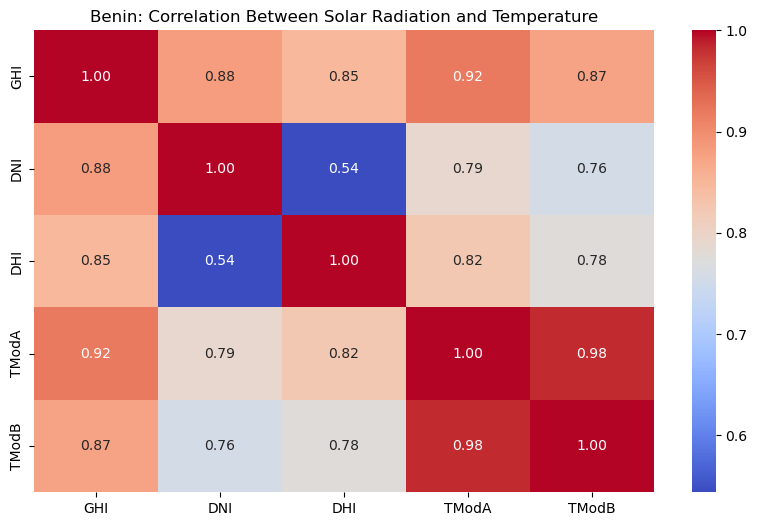

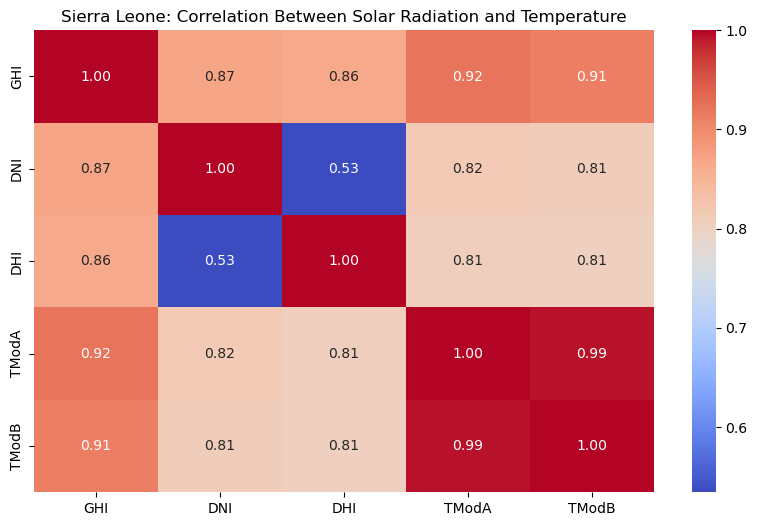

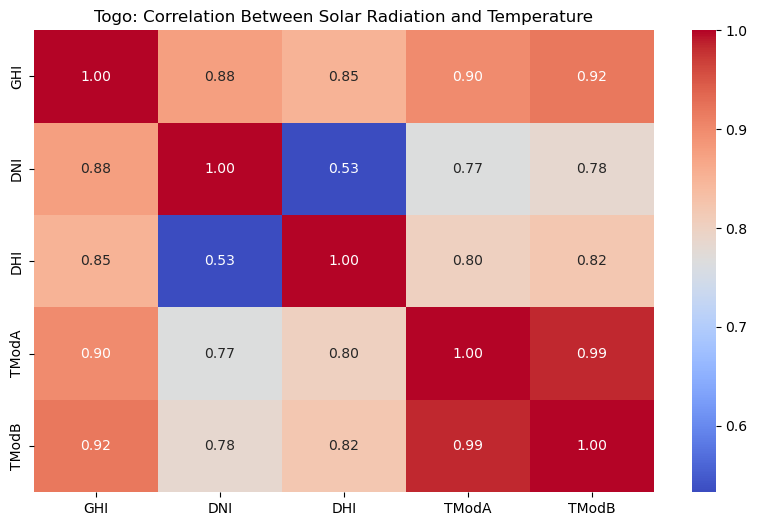

In [41]:
# Select relevant columns for correlation analysis
solar_temp_columns = ['GHI', 'DNI', 'DHI', 'TModA', 'TModB']

# Correlation matrix for Benin
correlation_benin = benin_df[solar_temp_columns].corr()

# Plot correlation heatmap for Benin
plt.figure(figsize=(10, 6))
sns.heatmap(correlation_benin, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Benin: Correlation Between Solar Radiation and Temperature")
plt.show()

# Repeat for Sierra Leone
correlation_sierraleone = sierraleone_df[solar_temp_columns].corr()
plt.figure(figsize=(10, 6))
sns.heatmap(correlation_sierraleone, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Sierra Leone: Correlation Between Solar Radiation and Temperature")
plt.show()

# Repeat for Togo
correlation_togo = togo_df[solar_temp_columns].corr()
plt.figure(figsize=(10, 6))
sns.heatmap(correlation_togo, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Togo: Correlation Between Solar Radiation and Temperature")
plt.show()

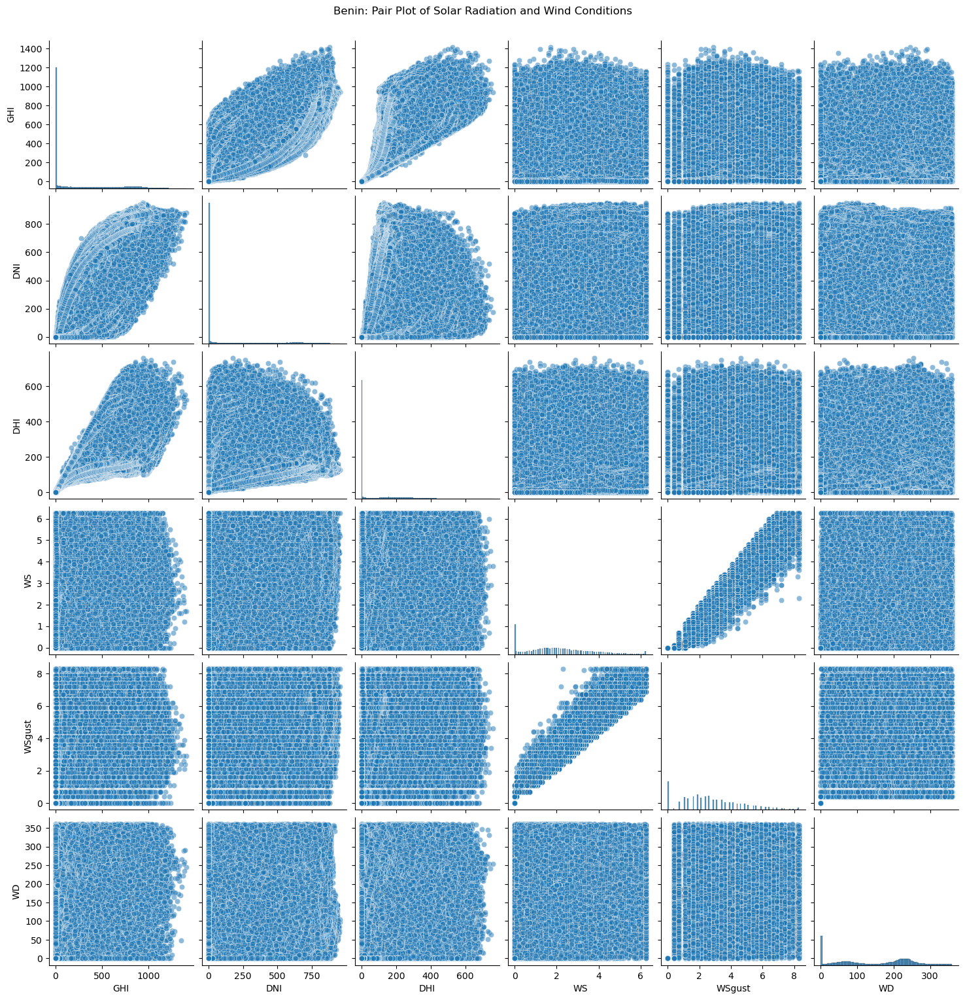

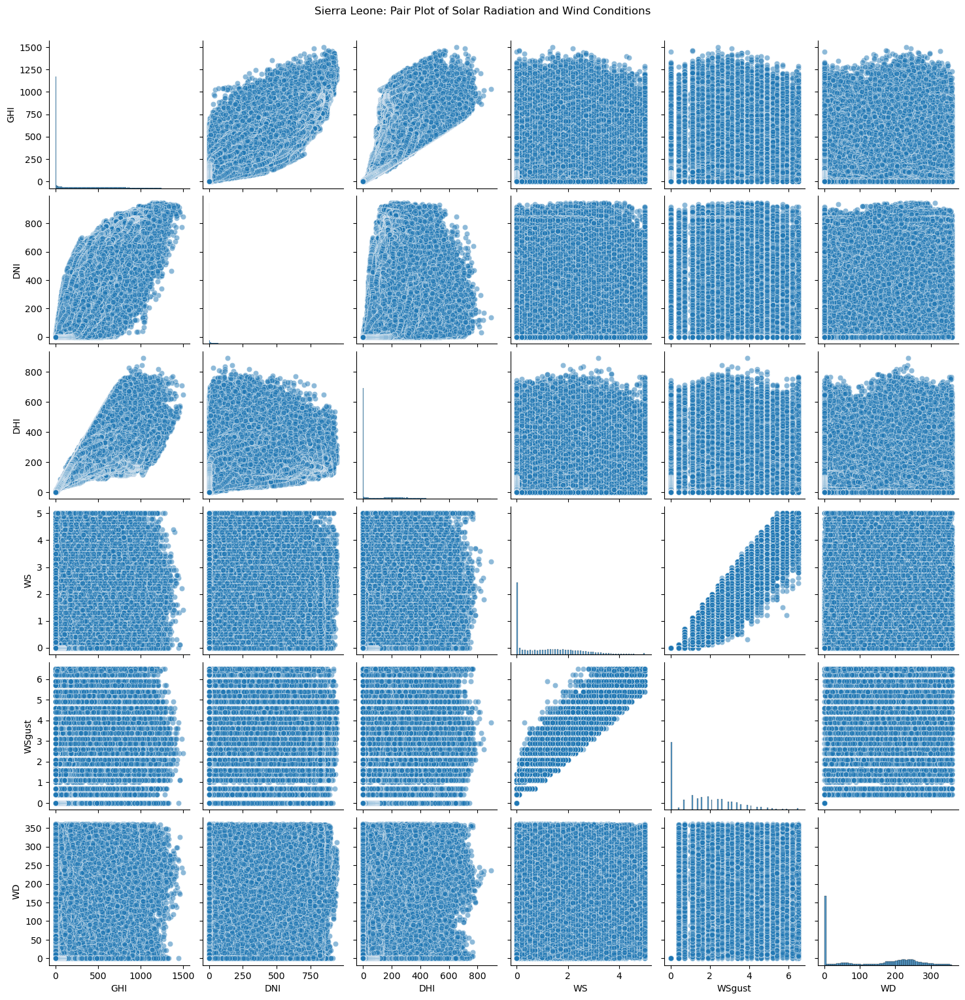

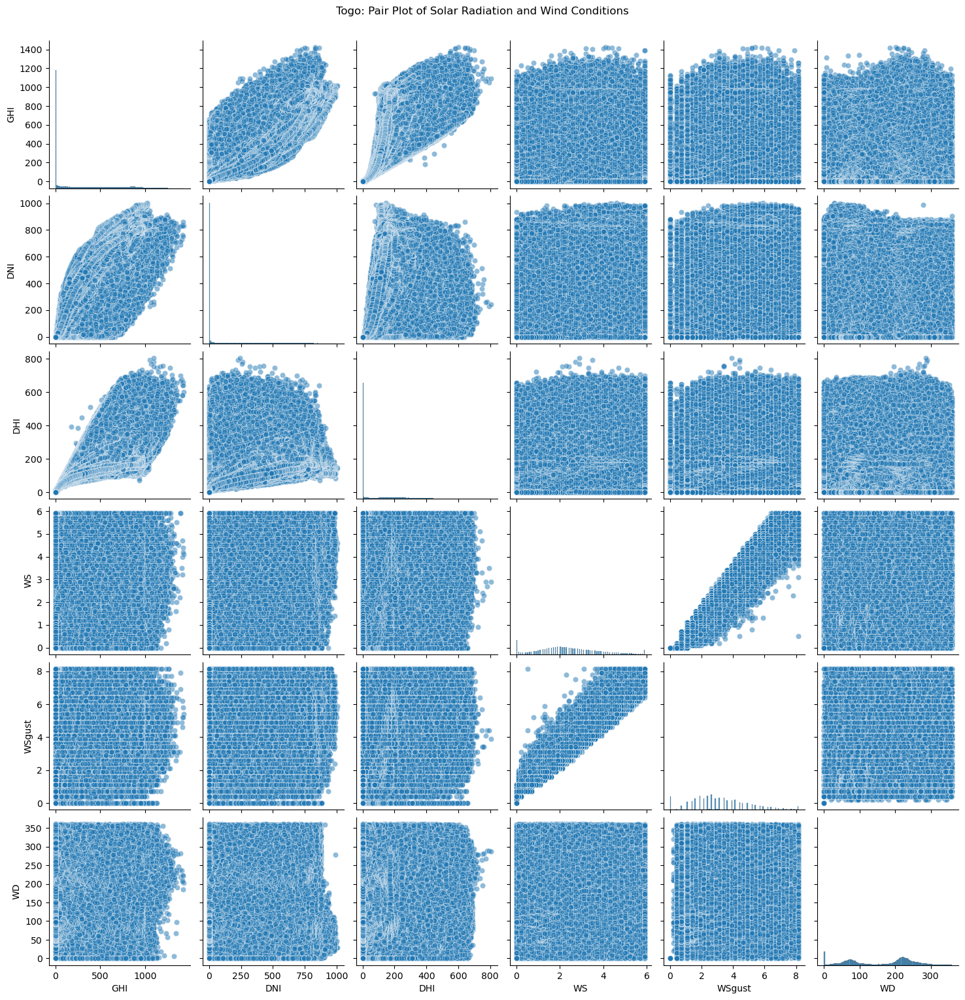

In [43]:
# Select relevant columns for scatter matrix
solar_wind_columns = ['GHI', 'DNI', 'DHI', 'WS', 'WSgust', 'WD']

# Pair plot for Benin
sns.pairplot(benin_df[solar_wind_columns], diag_kind='hist', plot_kws={'alpha': 0.5})
plt.suptitle("Benin: Pair Plot of Solar Radiation and Wind Conditions", y=1.02)
plt.show()

# Pair plot for Sierra Leone
sns.pairplot(sierraleone_df[solar_wind_columns], diag_kind='hist', plot_kws={'alpha': 0.5})
plt.suptitle("Sierra Leone: Pair Plot of Solar Radiation and Wind Conditions", y=1.02)
plt.show()

# Pair plot for Togo
sns.pairplot(togo_df[solar_wind_columns], diag_kind='hist', plot_kws={'alpha': 0.5})
plt.suptitle("Togo: Pair Plot of Solar Radiation and Wind Conditions", y=1.02)
plt.show()

#### Observations
1. Correlation Between Solar Radiation Components (GHI, DNI, DHI)
   - Strong Positive Correlations Across All Datasets
       - GHI and DNI: Correlations are high (~0.88 across all datasets). This indicates that direct sunlight is a significant contributor to the total solar radiation received.
       - GHI and DHI: Correlations are slightly lower (~0.85), but still strong. This reflects the contribution of scattered sunlight to total irradiance.
       - DNI and DHI: Moderate correlations (~0.54) suggest that direct and diffuse components have different influences and are somewhat independent of each other.
2. Correlation Between Solar Radiation and Temperature (TModA, TModB)
   - GHI vs. Temperatur
       -  High correlations (~0.90–0.92) show that higher total solar radiation is associated with increased module temperatures (TModA, TModB).
   - DNI vs. Temperature
       - Moderate correlations (~0.77–0.82). Direct sunlight (DNI) impacts module temperature significantly, though not as strongly as total solar radiation (GHI).
   C. DHI vs. Temperature
       - Moderate correlations (~0.78–0.82). Diffuse sunlight contributes less to heating the modules compared to GHI or DNI.
3. Temperature Correlation Between TModA and TModB
   - Near-Perfect Correlation Across All Datasets (~0.99): Indicates that the two temperature sensors (Module A and Module B) are consistent in capturing the same temperature patterns.

#### Comparison Across Datasets
1. The trends and correlation values are highly consistent across all three datasets
2. Slight variations in correlation values (e.g., GHI vs. DNI in Togo being slightly higher than Benin or Sierra Leone) may reflect differences in local environmental conditions.

#### Insights for Solar Strategy
1. Solar Radiation is Highly Predictive of Module Temperature: High correlations between GHI and module temperatures suggest that higher solar radiation directly translates into higher efficiency of solar panels, but it may also lead to overheating.
2. Direct (DNI) and Diffuse (DHI) Contributions: While DNI is a stronger predictor of total solar radiation (GHI), DHI plays an important role in regions with frequent cloud cover, as reflected in its correlation with GHI and temperatures.
3. Monitoring Module Temperatures: Given the near-perfect correlation between TModA and TModB, the sensors provide reliable data for temperature monitoring. Overheating concerns should be addressed during peak GHI months.

## SECTION SIX
### Wind Analysis
Use radial bar plots or wind roses Identify trends and significant wind events by showing the distribution of wind speed and direction, along with how variable the wind direction tends to be

/var/folders/8q/3jn0l2r571s39320x9v3km1c0000gn/T/ipykernel_23435/1026544310.py:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  wind_data = df.groupby(['WindDirectionBins', 'WindSpeedCategory']).size().unstack(fill_value=0)


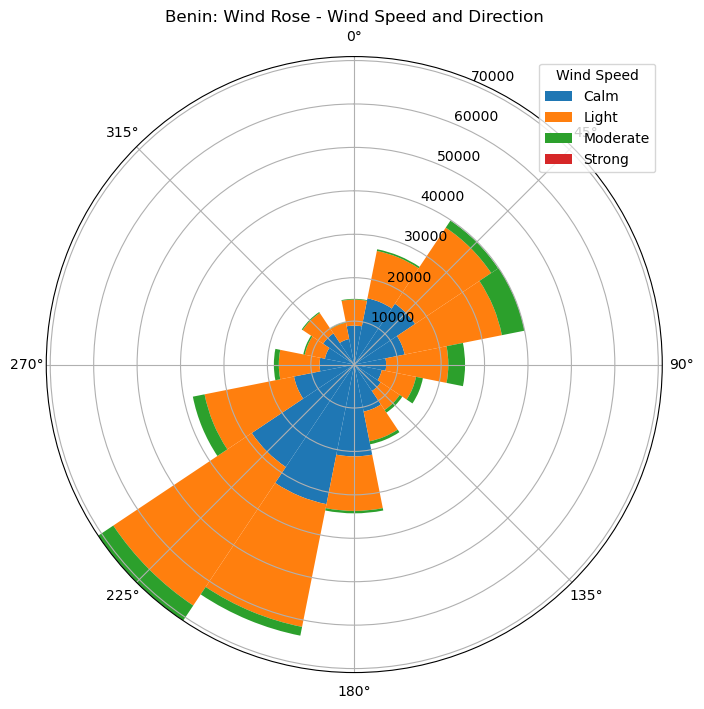

/var/folders/8q/3jn0l2r571s39320x9v3km1c0000gn/T/ipykernel_23435/1026544310.py:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  wind_data = df.groupby(['WindDirectionBins', 'WindSpeedCategory']).size().unstack(fill_value=0)


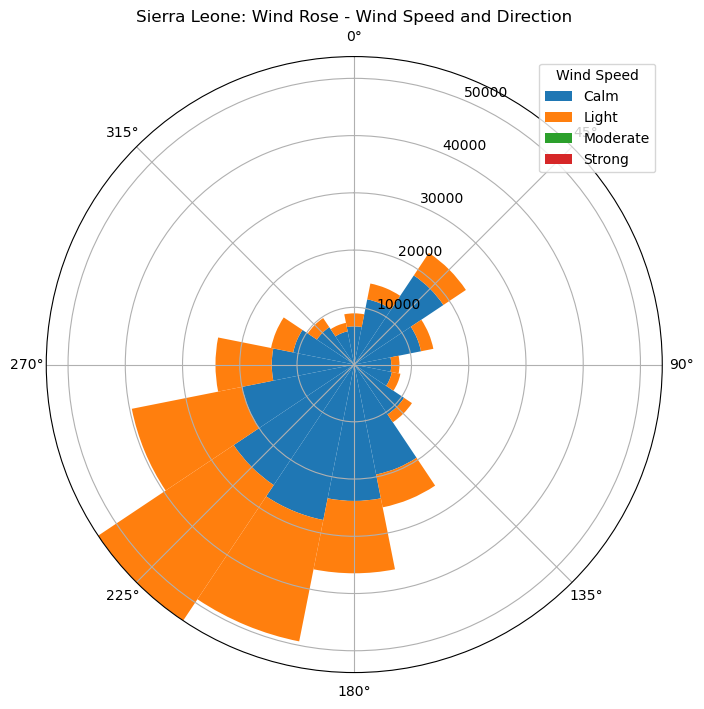

/var/folders/8q/3jn0l2r571s39320x9v3km1c0000gn/T/ipykernel_23435/1026544310.py:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  wind_data = df.groupby(['WindDirectionBins', 'WindSpeedCategory']).size().unstack(fill_value=0)


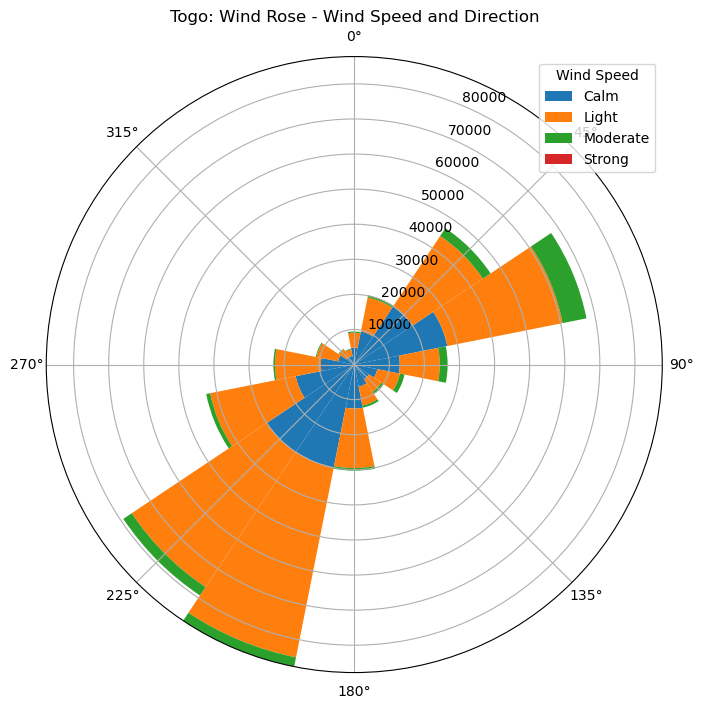

In [48]:
# Function to create a simple wind rose
def simple_wind_rose(df, title):
    # Bin wind directions into 16 compass directions
    df['WindDirectionBins'] = pd.cut(df['WD'], bins=np.linspace(0, 360, 17), labels=np.arange(0, 360, 22.5))
    wind_speed_categories = ['Calm', 'Light', 'Moderate', 'Strong']
    wind_speed_bins = [0, 2, 5, 8, np.inf]  # Define wind speed bins (e.g., calm < 2 m/s, strong > 8 m/s)
    df['WindSpeedCategory'] = pd.cut(df['WS'], bins=wind_speed_bins, labels=wind_speed_categories)

    # Prepare data for plotting
    wind_data = df.groupby(['WindDirectionBins', 'WindSpeedCategory']).size().unstack(fill_value=0)

    # Create a polar plot
    theta = np.deg2rad(wind_data.index.astype(float))  # Convert direction bins to radians
    fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(10, 8))
    bottom = np.zeros(len(wind_data))

    for category in wind_speed_categories:
        radii = wind_data[category]
        bars = ax.bar(theta, radii, width=np.radians(22.5), bottom=bottom, label=category)
        bottom += radii

    # Customize the plot
    ax.set_theta_direction(-1)
    ax.set_theta_zero_location("N")
    ax.legend(title="Wind Speed")
    plt.title(title)
    plt.show()

# Plot wind rose for Benin
simple_wind_rose(benin_df, "Benin: Wind Rose - Wind Speed and Direction")

# Plot wind rose for Sierra Leone
simple_wind_rose(sierraleone_df, "Sierra Leone: Wind Rose - Wind Speed and Direction")

# Plot wind rose for Togo
simple_wind_rose(togo_df, "Togo: Wind Rose - Wind Speed and Direction")

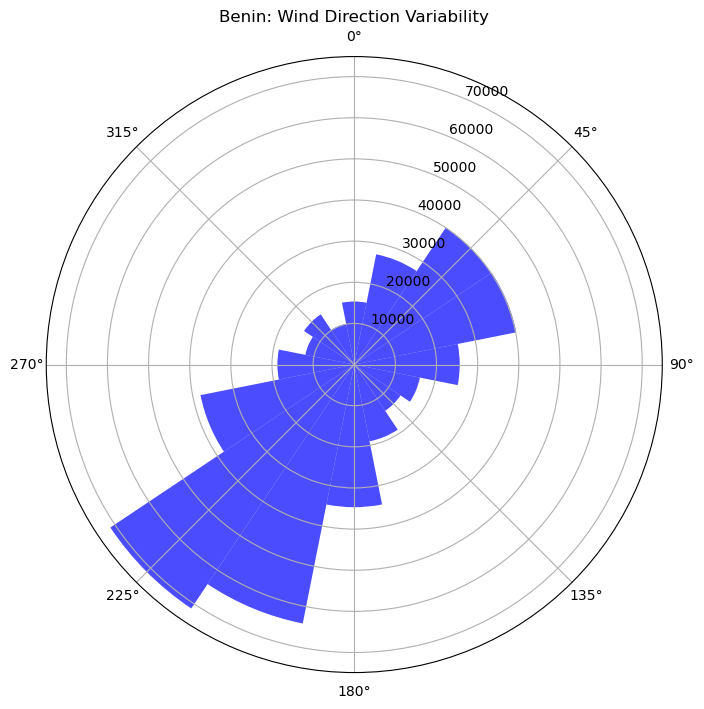

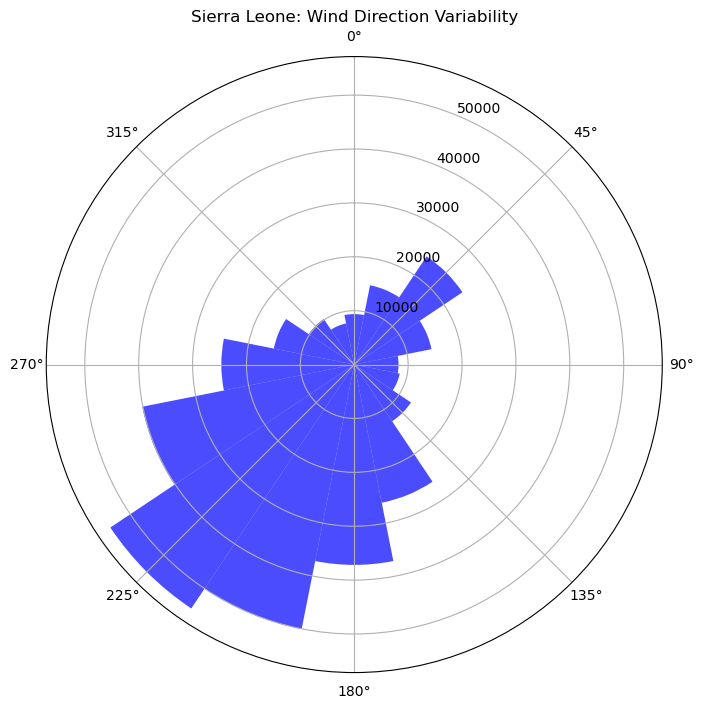

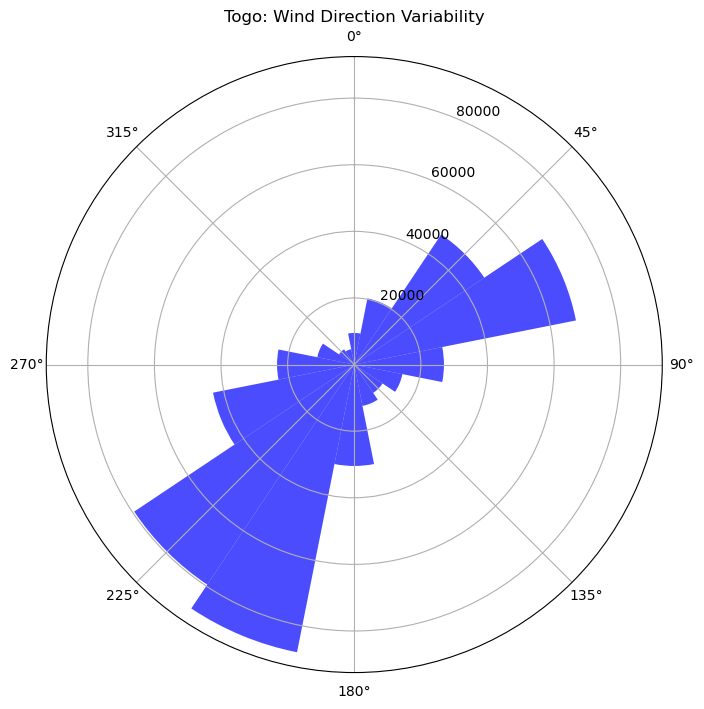

In [49]:
# Function to create a radial bar plot
def radial_bar_plot(df, title):
    # Bin wind directions into 16 compass directions
    df['WindDirectionBins'] = pd.cut(df['WD'], bins=np.linspace(0, 360, 17), labels=np.arange(0, 360, 22.5))
    wind_counts = df['WindDirectionBins'].value_counts(sort=False)

    # Plot radial bar chart
    theta = np.deg2rad(wind_counts.index.astype(float))  # Convert to radians
    radii = wind_counts.values

    fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(8, 8))
    bars = ax.bar(theta, radii, width=np.radians(22.5), bottom=0, color='blue', alpha=0.7)

    ax.set_theta_direction(-1)
    ax.set_theta_zero_location("N")  # North at the top
    plt.title(title)
    plt.show()

# Radial bar plot for Benin
radial_bar_plot(benin_df, "Benin: Wind Direction Variability")

# Radial bar plot for Sierra Leone
radial_bar_plot(sierraleone_df, "Sierra Leone: Wind Direction Variability")

# Radial bar plot for Togo
radial_bar_plot(togo_df, "Togo: Wind Direction Variability")

#### Observations
##### Insights from the Wind Analysis
1. Wind Rose Insights
   - Benin: Dominant wind directions are concentrated around 225° (southwest) and 180° (south). Wind speeds are predominantly in the Calm and Light categories, with occasional Moderate winds. Strong winds are relatively rare but occur primarily from specific directions.
   - Sierra Leone: Similar to Benin, dominant wind directions are around 225° (southwest). A higher proportion of Calm and Light winds, with very few occurrences of Moderate and Strong winds. This suggests a generally stable wind pattern with limited extreme wind conditions.
   - Togo: The dominant wind directions align more with 135° (southeast) and 180° (south). There is a higher prevalence of Light winds compared to the other datasets, with some Moderate winds. Strong winds are rare, consistent with the overall pattern of calm to light wind dominance.
##### Key Takeaways
1. Dominant Wind Directions: Across all three regions, the southwest to south directions (135° to 225°) dominate, with occasional variations.
2. Wind Speed Trends: Calm and Light winds dominate in all regions, which might positively influence solar panel performance by reducing the risk of physical damage. Moderate and Strong winds are infrequent but should still be considered for solar panel placement and securing.
3. Impact on Solar Installations: The consistent wind direction patterns can aid in designing solar panel layouts that minimize dust accumulation and enhance cooling. The variability in wind directions in Togo suggests that extra precautions might be needed to secure installations.

## SECTION SEVEN
### Temperature Analysis
Temperature Analysis: Examine how relative humidity (RH) might influence temperature readings and solar radiation.

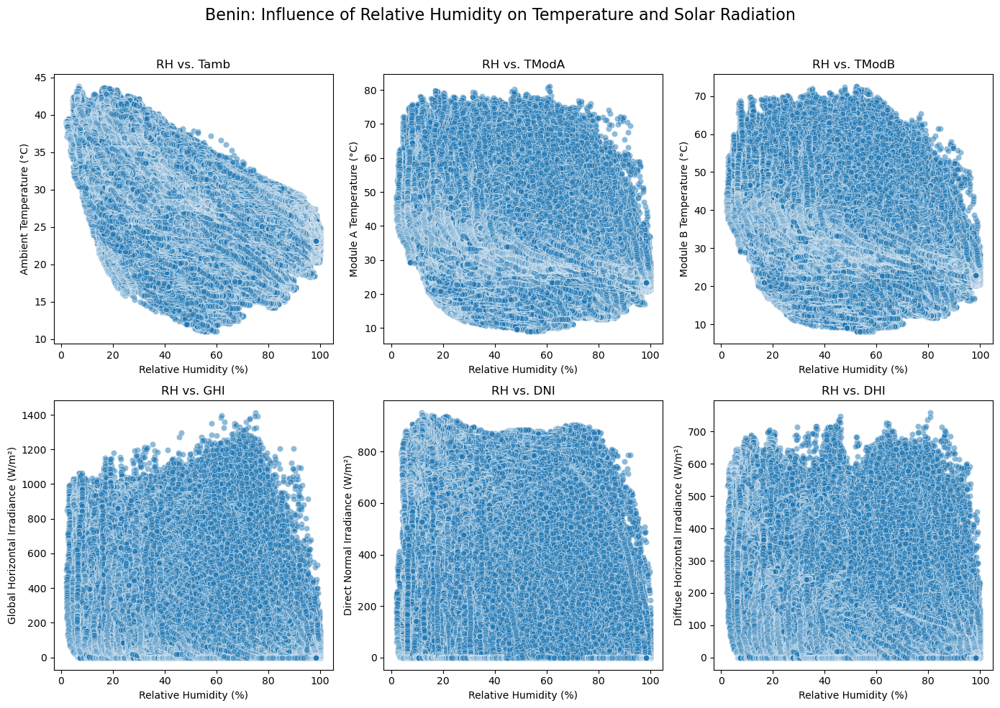

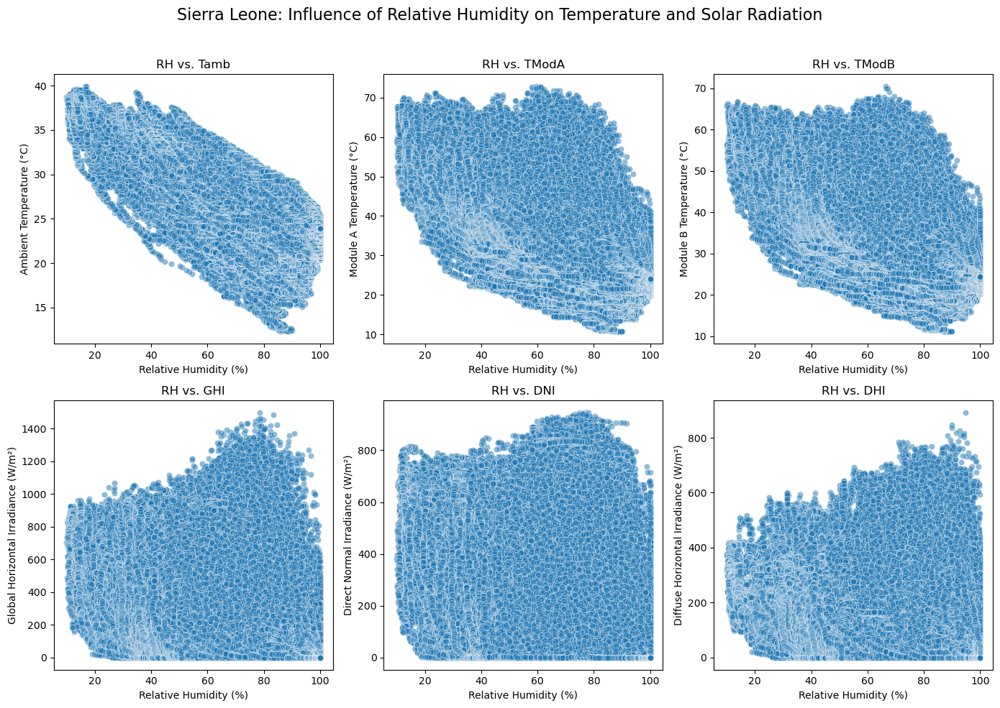

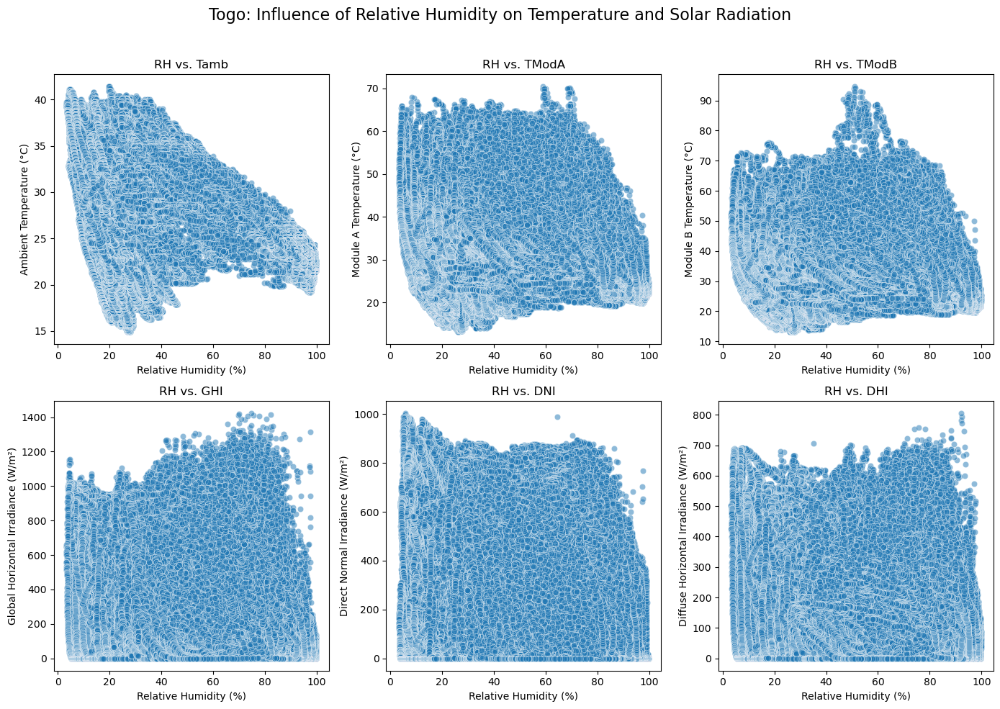

In [50]:
def plot_temperature_vs_rh(df, region):
    plt.figure(figsize=(14, 10))
    plt.suptitle(f"{region}: Influence of Relative Humidity on Temperature and Solar Radiation", fontsize=16)

    # Scatter plot: RH vs Tamb
    plt.subplot(2, 3, 1)
    sns.scatterplot(x=df['RH'], y=df['Tamb'], alpha=0.5)
    plt.title("RH vs. Tamb")
    plt.xlabel("Relative Humidity (%)")
    plt.ylabel("Ambient Temperature (°C)")

    # Scatter plot: RH vs TModA
    plt.subplot(2, 3, 2)
    sns.scatterplot(x=df['RH'], y=df['TModA'], alpha=0.5)
    plt.title("RH vs. TModA")
    plt.xlabel("Relative Humidity (%)")
    plt.ylabel("Module A Temperature (°C)")

    # Scatter plot: RH vs TModB
    plt.subplot(2, 3, 3)
    sns.scatterplot(x=df['RH'], y=df['TModB'], alpha=0.5)
    plt.title("RH vs. TModB")
    plt.xlabel("Relative Humidity (%)")
    plt.ylabel("Module B Temperature (°C)")

    # Scatter plot: RH vs GHI
    plt.subplot(2, 3, 4)
    sns.scatterplot(x=df['RH'], y=df['GHI'], alpha=0.5)
    plt.title("RH vs. GHI")
    plt.xlabel("Relative Humidity (%)")
    plt.ylabel("Global Horizontal Irradiance (W/m²)")

    # Scatter plot: RH vs DNI
    plt.subplot(2, 3, 5)
    sns.scatterplot(x=df['RH'], y=df['DNI'], alpha=0.5)
    plt.title("RH vs. DNI")
    plt.xlabel("Relative Humidity (%)")
    plt.ylabel("Direct Normal Irradiance (W/m²)")

    # Scatter plot: RH vs DHI
    plt.subplot(2, 3, 6)
    sns.scatterplot(x=df['RH'], y=df['DHI'], alpha=0.5)
    plt.title("RH vs. DHI")
    plt.xlabel("Relative Humidity (%)")
    plt.ylabel("Diffuse Horizontal Irradiance (W/m²)")

    plt.tight_layout(rect=[0, 0, 1, 0.96])
    plt.show()

# Plot for Benin
plot_temperature_vs_rh(benin_df, "Benin")

# Plot for Sierra Leone
plot_temperature_vs_rh(sierraleone_df, "Sierra Leone")

# Plot for Togo
plot_temperature_vs_rh(togo_df, "Togo")

In [51]:
def calculate_correlations(df, region):
    correlations = df[['RH', 'Tamb', 'TModA', 'TModB', 'GHI', 'DNI', 'DHI']].corr()
    print(f"{region}: Correlation of RH with Temperatures and Solar Radiation")
    print(correlations['RH'])
    print("\n")

# Correlations for Benin
calculate_correlations(benin_df, "Benin")

# Correlations for Sierra Leone
calculate_correlations(sierraleone_df, "Sierra Leone")

# Correlations for Togo
calculate_correlations(togo_df, "Togo")

Benin: Correlation of RH with Temperatures and Solar Radiation
RH       1.000000
Tamb    -0.414842
TModA   -0.343841
TModB   -0.319846
GHI     -0.361773
DNI     -0.373748
DHI     -0.289731
Name: RH, dtype: float64


Sierra Leone: Correlation of RH with Temperatures and Solar Radiation
RH       1.000000
Tamb    -0.791937
TModA   -0.688057
TModB   -0.698477
GHI     -0.549395
DNI     -0.548873
DHI     -0.435457
Name: RH, dtype: float64


Togo: Correlation of RH with Temperatures and Solar Radiation
RH       1.000000
Tamb    -0.400410
TModA   -0.244825
TModB   -0.224668
GHI     -0.259684
DNI     -0.327887
DHI     -0.155016
Name: RH, dtype: float64




#### Observations
1. Relative humidity has a noticeable dampening effect on solar radiation and temperature.
2. The patterns across the datasets for all regions (Benin, Sierra Leone, and Togo) are remarkably similar, indicating a consistent relationship between RH and the environmental conditions.
3. Strongest Influence in Sierra Leone: The correlations in Sierra Leone are generally stronger than in Benin and Togo, indicating that RH has a more significant impact on temperature and solar radiation in this region.
4. Temperatures vs. Solar Radiation: Across all regions, RH has a stronger negative correlation with temperatures (Tamb, TModA, TModB) than with solar radiation (GHI, DNI, DHI). This suggests that RH affects temperature more directly than it does solar irradiance.
5. Diffuse Radiation (DHI): DHI consistently has the weakest negative correlation with RH, highlighting its relative resilience to changes in humidity compared to GHI and DNI.

## SECTION EIGHT
### Histograms
Histograms: Create histograms for variables like GHI, DNI, DHI, WS, and temperatures to visualize the frequency distribution of these variables.


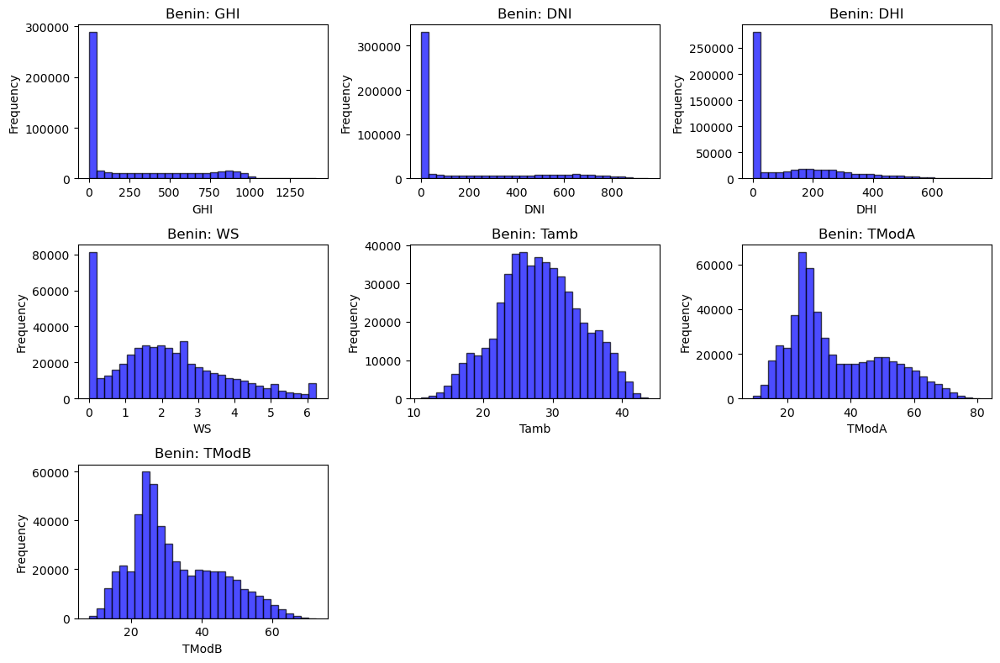

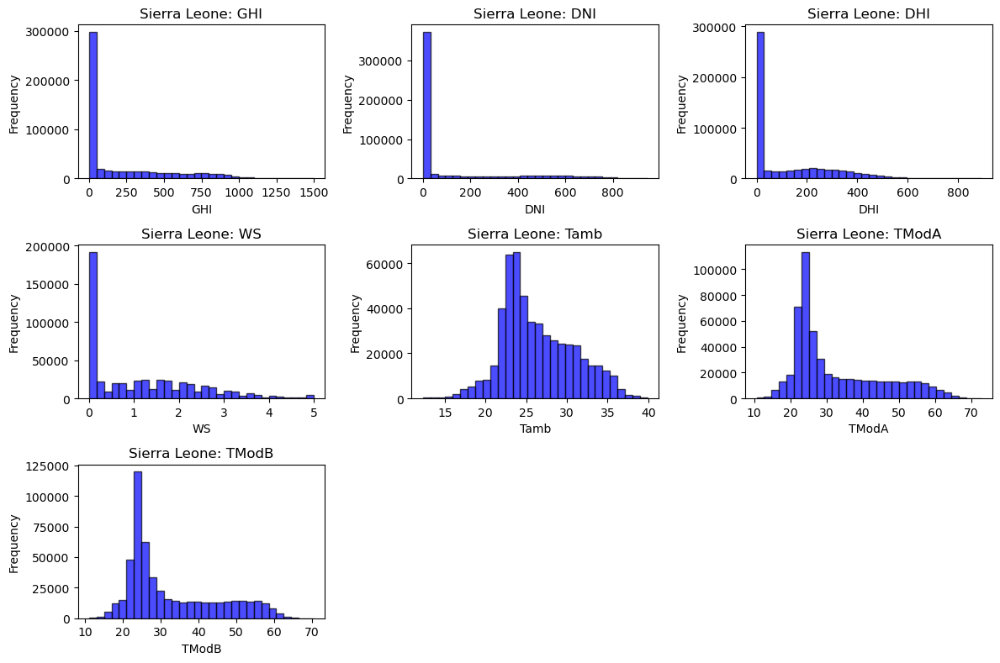

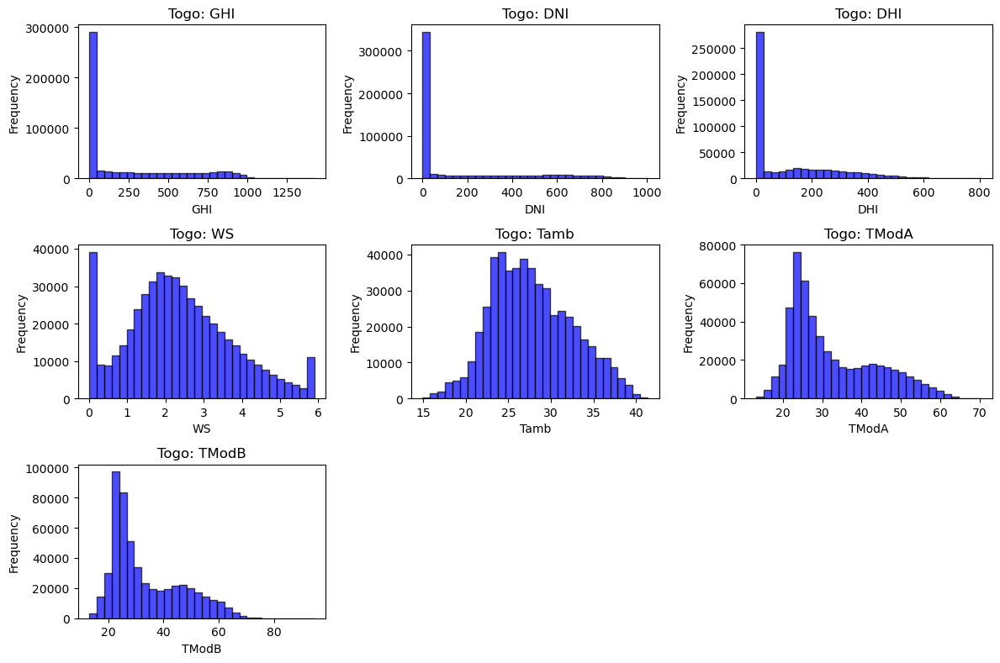

In [54]:
# List of columns for histograms
columns_to_plot = ['GHI', 'DNI', 'DHI', 'WS', 'Tamb', 'TModA', 'TModB']

# Plot histograms for each dataset
for df, region in zip([benin_df, sierraleone_df, togo_df], ['Benin', 'Sierra Leone', 'Togo']):
    plt.figure(figsize=(12, 8))
    for i, col in enumerate(columns_to_plot, start=1):
        plt.subplot(3, 3, i)
        plt.hist(df[col], bins=30, alpha=0.7, color='blue', edgecolor='black')
        plt.title(f'{region}: {col}')
        plt.xlabel(col)
        plt.ylabel('Frequency')
    plt.tight_layout()
    plt.show()

#### Observations
1. Solar Radiation (GHI, DNI, DHI): Skewed distributions with a high frequency of low values and a few extreme high values.
2. Wind Speed (WS): Most values are below 2 m/s, with a gradual decrease in frequency as speed increases.
3. Temperatures (Tamb, TModA, TModB): Normal distributions with peaks around their respective means.

## SECTION NINE
### Z-Score Analysis
Calculate Z-scores to flag data points that are significantly different from the mean


In [55]:
# Function to calculate Z-scores and flag anomalies
def calculate_z_scores(df, columns):
    anomalies = {}
    for col in columns:
        mean = df[col].mean()
        std_dev = df[col].std()
        z_scores = (df[col] - mean) / std_dev
        anomalies[col] = df[np.abs(z_scores) > 3]  # Flag points with |Z| > 3
    return anomalies

# Z-score analysis for all datasets
z_columns = ['GHI', 'DNI', 'DHI', 'WS', 'Tamb', 'TModA', 'TModB']
benin_anomalies = calculate_z_scores(benin_df, z_columns)
sierra_anomalies = calculate_z_scores(sierraleone_df, z_columns)
togo_anomalies = calculate_z_scores(togo_df, z_columns)

# Display flagged anomalies
for region, anomalies in zip(['Benin', 'Sierra Leone', 'Togo'], [benin_anomalies, sierra_anomalies, togo_anomalies]):
    print(f'{region} anomalies:')
    for col, data in anomalies.items():
        print(f'{col}: {len(data)} anomalies flagged')

Benin anomalies:
GHI: 90 anomalies flagged
DNI: 2 anomalies flagged
DHI: 3889 anomalies flagged
WS: 0 anomalies flagged
Tamb: 0 anomalies flagged
TModA: 10 anomalies flagged
TModB: 98 anomalies flagged
Sierra Leone anomalies:
GHI: 2574 anomalies flagged
DNI: 7594 anomalies flagged
DHI: 3202 anomalies flagged
WS: 4500 anomalies flagged
Tamb: 192 anomalies flagged
TModA: 100 anomalies flagged
TModB: 4 anomalies flagged
Togo anomalies:
GHI: 314 anomalies flagged
DNI: 1062 anomalies flagged
DHI: 3415 anomalies flagged
WS: 0 anomalies flagged
Tamb: 0 anomalies flagged
TModA: 153 anomalies flagged
TModB: 609 anomalies flagged


#### Observations
1. Higher temperatures are generally associated with higher GHI values.
2. The size of the bubbles (representing wind speed) suggests little variation in wind speed for most high GHI values.

## SECTION TEN
### Bubble charts
Bubble charts to explore complex relationships between variables, such as GHI vs. Tamb vs. WS, with bubble size representing an additional variable like RH or BP (Barometric Pressure)



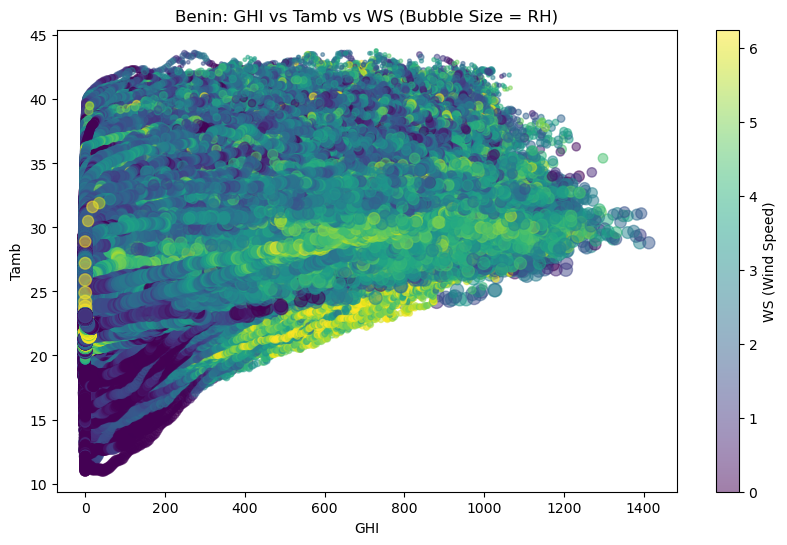

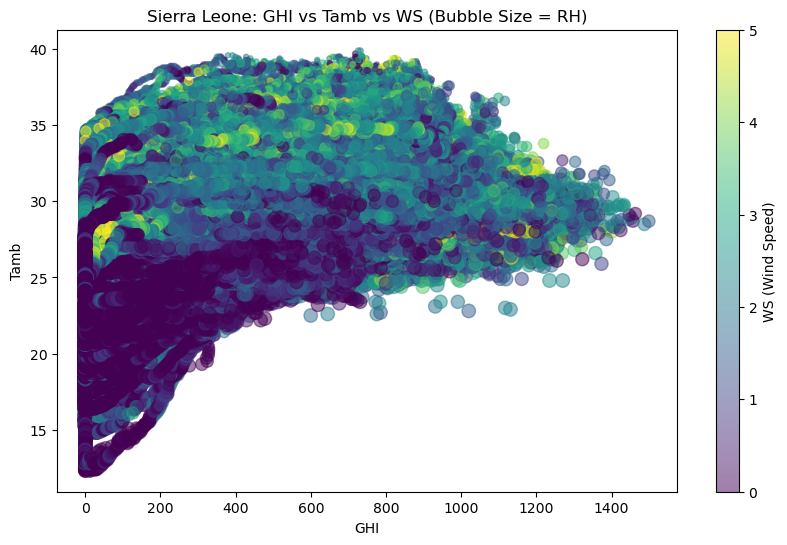

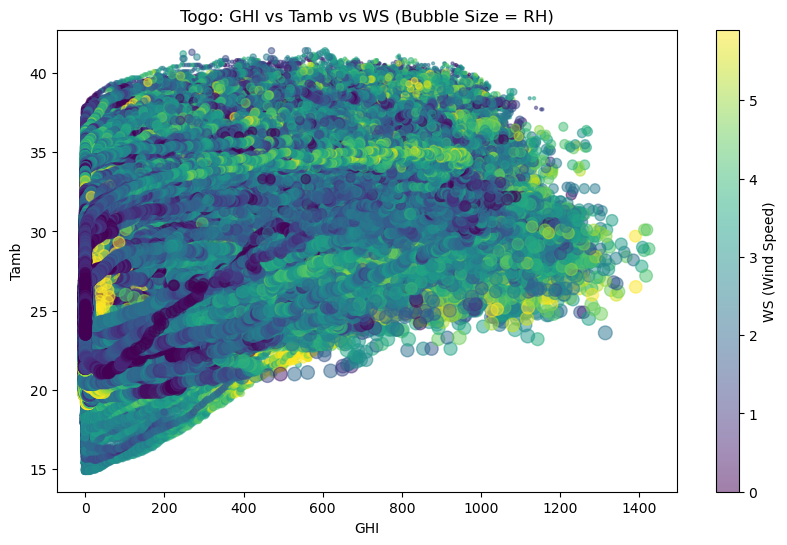

In [56]:
# Bubble Chart for each dataset
for df, region in zip([benin_df, sierraleone_df, togo_df], ['Benin', 'Sierra Leone', 'Togo']):
    plt.figure(figsize=(10, 6))
    plt.scatter(df['GHI'], df['Tamb'], s=df['RH'], alpha=0.5, c=df['WS'], cmap='viridis')
    plt.title(f'{region}: GHI vs Tamb vs WS (Bubble Size = RH)')
    plt.xlabel('GHI')
    plt.ylabel('Tamb')
    plt.colorbar(label='WS (Wind Speed)')
    plt.show()

#### Observations
1. The Z-score analysis flagged anomalies for each variable:
    - Benin: GHI (90), DNI (2), DHI (3889), TModA (10), TModB (98).
    - Sierra Leone: Higher anomaly counts in GHI, DNI, DHI, WS, and Tamb.
    - Togo: Moderate anomaly counts for GHI, DNI, and DHI; high anomalies in TModA and TModB.

## SECTION ELEVEN
### Data Cleaning
Based on the initial analysis, clean the dataset by handling anomalies and missing values, especially in columns like Comments which appear entirely null.

In [57]:
# Cleaning 'Comments' column and anomalies
def clean_dataset(df, anomalies_dict):
    # Drop 'Comments' column if entirely null
    if 'Comments' in df.columns and df['Comments'].isnull().all():
        df = df.drop(columns=['Comments'])
    
    # Drop anomalies
    for col, anomalies in anomalies_dict.items():
        df = df[~df.index.isin(anomalies.index)]
    return df

# Clean each dataset
benin_cleaned = clean_dataset(benin_df, benin_anomalies)
sierra_cleaned = clean_dataset(sierraleone_df, sierra_anomalies)
togo_cleaned = clean_dataset(togo_df, togo_anomalies)

# Display shape of cleaned datasets
for region, df in zip(['Benin', 'Sierra Leone', 'Togo'], [benin_cleaned, sierra_cleaned, togo_cleaned]):
    print(f'{region}: Cleaned dataset shape = {df.shape}')

Benin: Cleaned dataset shape = (521529, 19)
Sierra Leone: Cleaned dataset shape = (509146, 19)
Togo: Cleaned dataset shape = (520217, 19)


#### Observations
1. After handling anomalies and missing values:
    - Benin: Cleaned dataset reduced to 521,529 rows.
    - Sierra Leone: Cleaned dataset reduced to 50,914 rows.
    - Togo: Cleaned dataset reduced to 520,217 rows.